In [1]:
import os
import sys
HOME = os.path.abspath('..')
sys.path.append(HOME)
os.chdir(HOME)

In [2]:
import torchvision
import dlib
from PIL import Image
from imutils import face_utils
from src.data.dataprep_mediapipe import *
from src.data.imgutils import *
from src.features.features_extractors_mediapipe import *

In [3]:
HOME

'/Users/samirchar/Google_Drive/Masters/DSI Scholars/stroke_detection'

In [40]:
DUMMY_DATA_PATH = 'data/dummy_data/'
DUMMY_DATA_2_PATH = DUMMY_DATA_PATH+'samir/'
video = torchvision.io.read_video('data/raw/3_face_smile.mov')

/opt/anaconda3/lib/python3.7/site-packages/torchvision/io/video.py:106: UserWarning: The pts_unit 'pts' gives wrong results and will be removed in a follow-up version. Please use pts_unit 'sec'.
  warnings.warn("The pts_unit 'pts' gives wrong results and will be removed in a " +


In [43]:
FPS = video[2]['video_fps']

In [44]:
frames = video[0].transpose(1,2)

In [45]:
num_frames,H,W,C = frames.size()
print(num_frames)

280


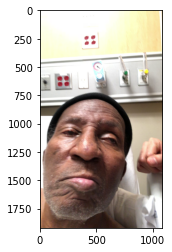

In [30]:
plt.imshow(frames[0])

In [9]:
landmarks_left_to_right_mapping = {  
                                     0: 16,#
                                     1: 15,#
                                     2: 14,#
                                     3: 13,#
                                     4: 12,#
                                     5: 11,#
                                     6: 10,#
                                     7: 9,#
                                     17: 26,
                                     18: 25,
                                     19: 24,
                                     20: 23,
                                     21: 22,
                                     36: 45,
                                     37: 44,
                                     38: 43,
                                     39: 42,
                                     40: 47,
                                     41: 46,
                                     31: 35,
                                     32: 34,
                                     48: 54,
                                     49: 53,#
                                     50: 52,#
                                     60: 64,#
                                     61: 63,#
                                     67: 65,#
                                     59: 55,#
                                     58: 56#
                                }



bo = BarycentricOperations(landmarks_left_to_right_mapping,
                           triangle_indices = [68,69,70])

In [10]:
test_images = {}

test_images['control_smile']=np.array(Image.open(DUMMY_DATA_2_PATH+'control_smile.jpeg'))

test_images['stroke_left_smile']=np.array(Image.open(DUMMY_DATA_2_PATH+'stroke_left_smile.jpeg'))
test_images['stroke_right_smile'] = np.array(Image.open(DUMMY_DATA_2_PATH+'stroke_right_smile.jpeg'))

test_images['control_eyebrow_lift'] = np.array(Image.open(DUMMY_DATA_2_PATH+'control_eyebrow_lift_v3.jpeg'))
test_images['stroke_eyebrow_lift'] = np.array(Image.open(DUMMY_DATA_2_PATH+'stroke_eyebrow_lift_v3.jpeg'))
test_images['rotated_face']=np.array(Image.open(DUMMY_DATA_2_PATH+'rotated_face_v2.jpeg'))



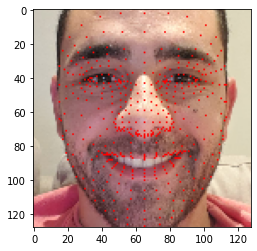

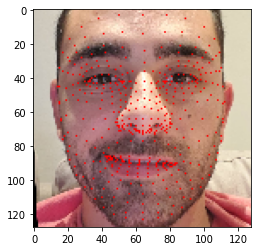

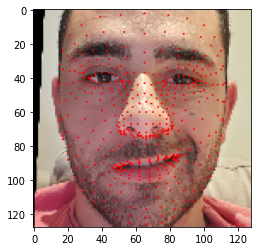

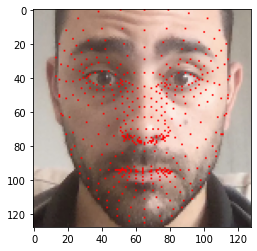

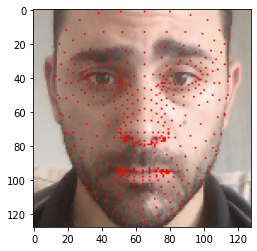

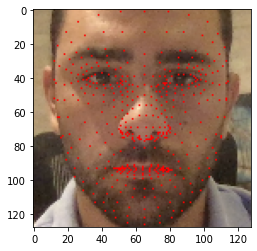

In [27]:
selected_landmarks = -1
SIZE = 512
WIDTH = 800


for k,v in test_images.items():
    
    h,w,_ = v.shape
    detector = FaceMeshDetector(frame_height = h,
                                frame_width = w)
    
    img,face = detector.process_one_face(v)

    img_drawn = detector.draw_faces(img,[face])
    
    
    processed_landmarks = face['process_landmarks']
    
    '''
    nose_mouth_features_ = nose_mouth_features(processed_landmarks)
    lmnx,lmny,lmnd,theta,rmnx,rmny,rmnd,phi = nose_mouth_features_

    h_eb_eb_devs = h_eyebrow_eyebrow_deviation(processed_landmarks, 
                            exclude=[17,18,19,24,25,26])
    
    barycentric_asymmetry = bo.global_asymmetry_index(
        processed_landmark_dict_to_array(processed_landmarks)
    )
    
    print(f'nose_mouth_angles: {theta,phi}')
    print(f'eyebrow horizontal deviations: {h_eb_eb_devs}')
    print(f'barycentric asymmetry: {barycentric_asymmetry}')
    print('\n\n================================================')
    '''
    plt.imshow(img_drawn)
    plt.show()

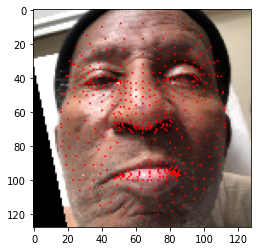

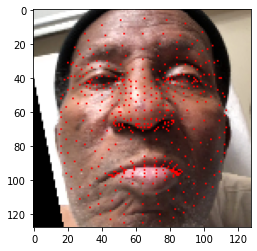

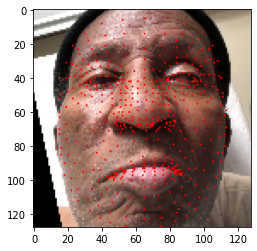

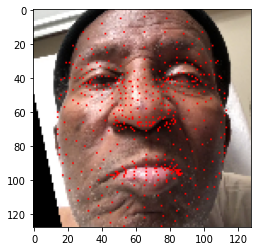

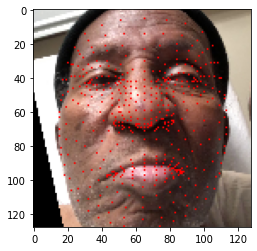

...

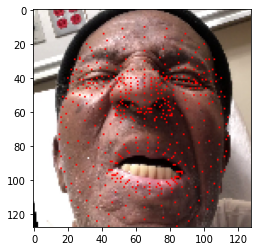

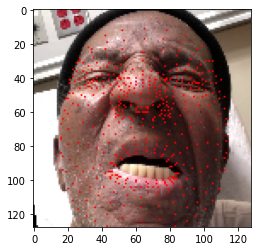

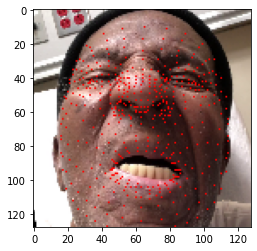

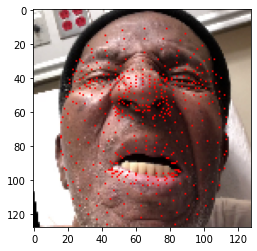

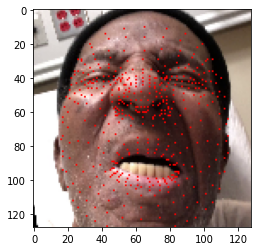

CPU times: user 2min 10s, sys: 20.5 s, total: 2min 30s
Wall time: 1min 5s


In [32]:
%%time
SIZE = 128
height,width,_ = frames[0].shape
selected_landmarks = -1

detector = FaceMeshDetector(frame_height = height,
                            frame_width = width)

for f in frames:
    
    img,face = detector.process_one_face(f)

    img_drawn = detector.draw_faces(img,[face])
    
    
    processed_landmarks = face['processed_landmarks']
    raw_landmarks = face['landmarks']
    
    plt.imshow(img_drawn)
    plt.show()
   

# Run all Live

In [16]:
import cv2
import time
import uuid 
#Constants
WIDTH = 800
SIZE = 256
ALIGN_METHOD = None
OPTICAL_FLOW_THRESHOLD = 2
SAVE_VIDEO = True
TIME_DURATION = 15


#Init
selected_landmarks = -1
op = OpticalFlow(flow_threshold = OPTICAL_FLOW_THRESHOLD)
ofs = OpticalFlowSymmetry()
pi = ProcessImage(predictor,detector,shape_predictor)
uuid_ = str(uuid.uuid1()).split('-')[0]




#Prev frame processing
cap = cv2.VideoCapture(0)
        
# Check if the webcam is opened correctly
if not cap.isOpened():
    raise IOError("Cannot open webcam")

_, frame_prev = cap.read()
original_frames = [frame_prev]

rect,frame_prev, gray_frame_prev, face_prev = pi.process(frame_prev,
                                                     width = WIDTH,
                                                     is_bgr = True,
                                                     method = ALIGN_METHOD,
                                                     size = SIZE)    


frame_drawn_prev = draw_landmarks(face_prev,
                                  frame_prev,
                                  gray_frame_prev,
                                  selected_landmarks,
                                  landmark_radius=SIZE//128)

processed_landmarks_prev = face_prev['landmarks']

    
of_temp = []
left_movement_temp = []
right_movement_temp = []
left_magnitudes_temp = []
right_magnitudes_temp = []
frames = []
num_frames = 0
time_start = time.time()

left_of_frames = []
right_of_frames = []


while time.time() < time_start + TIME_DURATION:

    #time.sleep(2)
    ret, frame = cap.read()
    
    original_frames.append(frame)

    rect,frame, gray_frame, face = pi.process(frame,
                                         width = WIDTH,
                                         is_bgr = True,
                                         method = ALIGN_METHOD,
                                         size = SIZE)    

    
    frame_drawn =  draw_landmarks(face,
                                  frame,
                                  gray_frame,
                                  selected_landmarks,
                                  landmark_radius=SIZE//128)
    
    
    processed_landmarks = face['landmarks']

    #Optical Flow
    re_prev = ROIExtractor(frame_prev,processed_landmarks_prev,debug=False)
    re = ROIExtractor(frame,processed_landmarks,debug=False)


    left_mouth_prev,left_mouth_prev_bounds = re_prev.left_mouth()
    right_mouth_prev,right_mouth_prev_bounds = re_prev.right_mouth()

    left_mouth,_ = re.left_mouth()
    right_mouth,_ = re.right_mouth()

    '''
    left_mouth,_ = re.left_mouth(project_to = left_project_coords)
    right_mouth,_ = re.right_mouth(project_to = right_project_coords)

    left_project_coords = [[left_mouth_prev_bounds[0],left_mouth_prev_bounds[2]],
                          [left_mouth_prev_bounds[1],left_mouth_prev_bounds[2]],
                          [left_mouth_prev_bounds[1],left_mouth_prev_bounds[3]],
                          [left_mouth_prev_bounds[0],left_mouth_prev_bounds[3]]]


    right_project_coords = [[right_mouth_prev_bounds[0],right_mouth_prev_bounds[2]],
                            [right_mouth_prev_bounds[1],right_mouth_prev_bounds[2]],
                            [right_mouth_prev_bounds[1],right_mouth_prev_bounds[3]],
                            [right_mouth_prev_bounds[0],right_mouth_prev_bounds[3]]]'''

    ##Size correction.
    left_mouth = cv2.resize(left_mouth,(left_mouth_prev.shape[1],left_mouth_prev.shape[0]))
    right_mouth = cv2.resize(right_mouth,(right_mouth_prev.shape[1],right_mouth_prev.shape[0]))                      

    
    left_magnitude, left_angle = op.compute_dense_flow(left_mouth_prev,left_mouth)
    left_magnitude = op.filter_flow_magnitude_noise(left_magnitude)
    left_rgb_of = op.get_rgb_optical_flow(left_magnitude, left_angle)

    right_magnitude, right_angle = op.compute_dense_flow(right_mouth_prev,right_mouth)
    right_magnitude = op.filter_flow_magnitude_noise(right_magnitude)
    right_rgb_of = op.get_rgb_optical_flow(right_magnitude, right_angle)
    
    left_of_frames.append(left_rgb_of)
    right_of_frames.append(right_rgb_of)
    
    left_movement_score = ofs.movement_score([left_magnitude])
    right_movement_score = ofs.movement_score([right_magnitude])


    of_mouth_symmetry_score = ofs.symmetry_score([left_magnitude],[right_magnitude],lambda_=10,ret='abs_diff')

    #Append to temporal lists
    of_temp.append(of_mouth_symmetry_score)
    right_movement_temp.append(right_movement_score)
    left_movement_temp.append(left_movement_score)
    right_magnitudes_temp.append(right_magnitude)
    left_magnitudes_temp.append(left_magnitude)


    nose_mouth_features_ = nose_mouth_features(processed_landmarks)

    lmnx,lmny,lmnd,theta,rmnx,rmny,rmnd,phi = nose_mouth_features_

    h_eb_eb_devs = h_eyebrow_eyebrow_deviation(processed_landmarks, 
                            exclude=[0,1,2])
    h_eb_eb_devs = np.round(h_eb_eb_devs,2)


    bo = BarycentricOperations(landmarks_left_to_right_mapping,
                       triangle_indices = [68,69,70])
    barycentric_asymmetry = bo.global_asymmetry_index(
    processed_landmark_dict_to_array(processed_landmarks))


    data_annotator = annotate_data(initial_h=int(frame.shape[0]*.1), interval_h=int(frame.shape[0]*.1))
    #frame_drawn = data_annotator.annotate(frame_drawn,'theta',round(theta))
    #frame_drawn = data_annotator.annotate(frame_drawn,'phi',round(phi))
    #frame_drawn = data_annotator.annotate(frame_drawn,'h_eb_dev',h_eb_eb_devs)
    #frame_drawn = data_annotator.annotate(frame_drawn,'b_asymmetry',round(barycentric_asymmetry,2))
    frame_drawn = data_annotator.annotate(frame_drawn,'of_m_s',round(of_mouth_symmetry_score,5))

    cv2.imshow('Input', frame_drawn)
    
    
    frames.append(frame_drawn)
    
    num_frames+=1

    c = cv2.waitKey(1)
    if c == 27:
        break
       
    # Updates previous frame info
    frame_prev = frame
    gray_frame_prev = gray_frame 
    frame_drawn_prev,face_prev = frame_drawn,face
    processed_landmarks_prev = processed_landmarks

fps = round(num_frames/TIME_DURATION)


# The following frees up resources and closes all windows
destroy_all_cam_windows(cap)


In [380]:

#Save Videos
height = width = SIZE
video_name = f'created_videos/processed_video_{uuid_}.avi'
video = cv2.VideoWriter(video_name, 0, fps, (SIZE,SIZE))

if SAVE_VIDEO:
    for i in frames:
        video.write(i)
        

#Save Videos
height, width,_ = original_frames[0].shape
video_name = f'created_videos/raw_video_{uuid_}.avi'
video = cv2.VideoWriter(video_name, 0, fps, (width,height))

if SAVE_VIDEO:
    for i in original_frames:
        video.write(i)

        
        
left_of_frames = [cv2.resize(i,(114,114)) for i in left_of_frames]
right_of_frames = [cv2.resize(i,(114,114)) for i in right_of_frames]


#Save Videos
height = width = SIZE
video_name = f'created_videos/left_mouth_{uuid_}.avi'
video = cv2.VideoWriter(video_name, 0, fps, (114,114))

if SAVE_VIDEO:
    for i in left_of_frames:
        video.write(i)


#Save Videos
height = width = SIZE
video_name = f'created_videos/right_mouth_{uuid_}.avi'
video = cv2.VideoWriter(video_name, 0, fps, (114,114))

if SAVE_VIDEO:
    for i in right_of_frames:
        video.write(i)


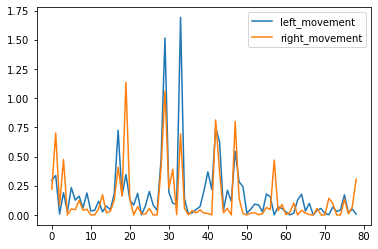

In [25]:
plt.plot(left_movement_temp,label='left_movement')
plt.plot(right_movement_temp,label='right_movement')
plt.legend()
plt.show()

No handles with labels found to put in legend.


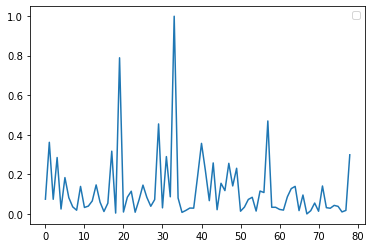

In [26]:
plt.plot(of_temp)
plt.legend()
plt.show()

# Run all Video

In [65]:
import cv2
import time
import uuid 
#Constants
SIZE = 256
OPTICAL_FLOW_THRESHOLD = 2
SAVE_VIDEO = True

#Init
selected_landmarks = -1
op = OpticalFlow(flow_threshold = OPTICAL_FLOW_THRESHOLD)
ofs = OpticalFlowSymmetry()                  

uuid_ = str(uuid.uuid1()).split('-')[0]


frame_prev = frames[0]
original_frames = [frame_prev]

                  
h,w,_ = frame_prev.shape
detector = FaceMeshDetector(frame_height=h,frame_width=w,desiredFaceWidthHeight= (SIZE,SIZE))


frame_prev,faces_prev = detector.process(frame_prev)
face_prev = faces_prev[0]
gray_frame_prev = cv2.cvtColor(frame_prev, cv2.COLOR_RGB2GRAY)
frame_drawn_prev = detector.draw_faces(frame_prev,faces_prev)
processed_landmarks_prev = face_prev['processed_landmarks']

of_temp = []
left_movement_temp = []
right_movement_temp = []
left_magnitudes_temp = []
right_magnitudes_temp = []
num_frames = 0
time_start = time.time()

left_of_frames = []
right_of_frames = []
frames_drawn = []

for frame in frames:
    original_frames.append(frame)    
    
    frame,faces = detector.process(frame)
    face = faces[0]
    gray_frame = cv2.cvtColor(frame, cv2.COLOR_RGB2GRAY)
    frame_drawn = detector.draw_faces(frame,faces)
    processed_landmarks = face['processed_landmarks']


    #Optical Flow
    re_prev = ROIExtractor(frame_prev,processed_landmarks_prev,debug=False)
    re = ROIExtractor(frame,processed_landmarks,debug=False)


    left_mouth_prev,left_mouth_prev_bounds = re_prev.left_mouth()
    right_mouth_prev,right_mouth_prev_bounds = re_prev.right_mouth()

    left_mouth,_ = re.left_mouth()
    right_mouth,_ = re.right_mouth()

    '''
    left_mouth,_ = re.left_mouth(project_to = left_project_coords)
    right_mouth,_ = re.right_mouth(project_to = right_project_coords)

    left_project_coords = [[left_mouth_prev_bounds[0],left_mouth_prev_bounds[2]],
                          [left_mouth_prev_bounds[1],left_mouth_prev_bounds[2]],
                          [left_mouth_prev_bounds[1],left_mouth_prev_bounds[3]],
                          [left_mouth_prev_bounds[0],left_mouth_prev_bounds[3]]]


    right_project_coords = [[right_mouth_prev_bounds[0],right_mouth_prev_bounds[2]],
                            [right_mouth_prev_bounds[1],right_mouth_prev_bounds[2]],
                            [right_mouth_prev_bounds[1],right_mouth_prev_bounds[3]],
                            [right_mouth_prev_bounds[0],right_mouth_prev_bounds[3]]]'''

    ##Size correction.
    left_mouth = cv2.resize(left_mouth,(left_mouth_prev.shape[1],left_mouth_prev.shape[0]))
    right_mouth = cv2.resize(right_mouth,(right_mouth_prev.shape[1],right_mouth_prev.shape[0]))                      

    
    left_magnitude, left_angle = op.compute_dense_flow(left_mouth_prev,left_mouth)
    left_magnitude = op.filter_flow_magnitude_noise(left_magnitude)
    left_rgb_of = op.get_rgb_optical_flow(left_magnitude, left_angle)

    right_magnitude, right_angle = op.compute_dense_flow(right_mouth_prev,right_mouth)
    right_magnitude = op.filter_flow_magnitude_noise(right_magnitude)
    right_rgb_of = op.get_rgb_optical_flow(right_magnitude, right_angle)
    
    left_of_frames.append(left_rgb_of)
    right_of_frames.append(right_rgb_of)
    
    left_movement_score = ofs.movement_score([left_magnitude])
    right_movement_score = ofs.movement_score([right_magnitude])


    of_mouth_symmetry_score = ofs.symmetry_score([left_magnitude],[right_magnitude],lambda_=10,ret='abs_diff')

    #Append to temporal lists
    of_temp.append(of_mouth_symmetry_score)
    right_movement_temp.append(right_movement_score)
    left_movement_temp.append(left_movement_score)
    right_magnitudes_temp.append(right_magnitude)
    left_magnitudes_temp.append(left_magnitude)

    '''
    nose_mouth_features_ = nose_mouth_features(processed_landmarks)

    lmnx,lmny,lmnd,theta,rmnx,rmny,rmnd,phi = nose_mouth_features_

    h_eb_eb_devs = h_eyebrow_eyebrow_deviation(processed_landmarks, 
                            exclude=[0,1,2])
    h_eb_eb_devs = np.round(h_eb_eb_devs,2)


    bo = BarycentricOperations(landmarks_left_to_right_mapping,
                       triangle_indices = [68,69,70])
    barycentric_asymmetry = bo.global_asymmetry_index(
    processed_landmark_dict_to_array(processed_landmarks))
    '''

    data_annotator = annotate_data(initial_h=int(frame.shape[0]*.1), interval_h=int(frame.shape[0]*.1))
    #frame_drawn = data_annotator.annotate(frame_drawn,'theta',round(theta))
    #frame_drawn = data_annotator.annotate(frame_drawn,'phi',round(phi))
    #frame_drawn = data_annotator.annotate(frame_drawn,'h_eb_dev',h_eb_eb_devs)
    #frame_drawn = data_annotator.annotate(frame_drawn,'b_asymmetry',round(barycentric_asymmetry,2))
    frame_drawn = data_annotator.annotate(frame_drawn,'of_m_s',round(of_mouth_symmetry_score,5))

    cv2.imshow('Input', frame_drawn)
    
    
    frames_drawn.append(frame_drawn)
    
    num_frames+=1

    c = cv2.waitKey(1)
    if c == 27:
        break
       
    # Updates previous frame info
    frame_prev = frame
    gray_frame_prev = gray_frame 
    frame_drawn_prev,face_prev = frame_drawn,face
    processed_landmarks_prev = processed_landmarks


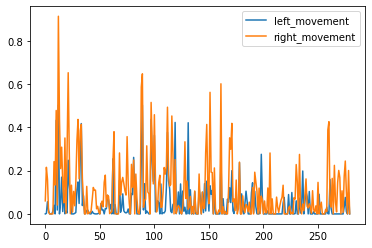

In [66]:
plt.plot(left_movement_temp,label='left_movement')
plt.plot(right_movement_temp,label='right_movement')
plt.legend()
plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


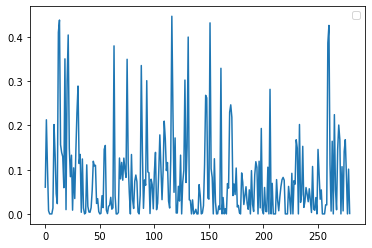

In [70]:
plt.plot(of_temp)
plt.legend()
plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


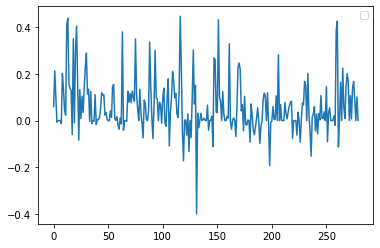

In [71]:
plt.plot(np.array(right_movement_temp)-np.array(left_movement_temp))
plt.legend()
plt.show()

In [60]:

#Save Videos
video_name = f'data/created_videos/processed_video_{uuid_}.avi'
video = cv2.VideoWriter(video_name, 0, FPS, (SIZE,SIZE))

if SAVE_VIDEO:
    for i in frames_drawn:
        video.write(i)
        


In [52]:
frames_drawn[0].shape

(128, 128, 3)

In [32]:

#Save Videos
height, width,_ = original_frames[0].shape
video_name = f'created_videos/raw_video_{uuid_}.avi'
video = cv2.VideoWriter(video_name, 0, fps, (width,height))

if SAVE_VIDEO:
    for i in original_frames:
        video.write(i)

        
        
left_of_frames = [cv2.resize(i,(114,114)) for i in left_of_frames]
right_of_frames = [cv2.resize(i,(114,114)) for i in right_of_frames]


#Save Videos
height = width = SIZE
video_name = f'created_videos/left_mouth_{uuid_}.avi'
video = cv2.VideoWriter(video_name, 0, fps, (114,114))

if SAVE_VIDEO:
    for i in left_of_frames:
        video.write(i)


#Save Videos
height = width = SIZE
video_name = f'created_videos/right_mouth_{uuid_}.avi'
video = cv2.VideoWriter(video_name, 0, fps, (114,114))

if SAVE_VIDEO:
    for i in right_of_frames:
        video.write(i)


tensor([[[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [251, 222, 161],
         [250, 221, 160],
         [249, 220, 159]],

        [[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [251, 222, 161],
         [249, 220, 159],
         [249, 220, 159]],

        [[255, 255, 255],
         [255, 255, 255],
         [255, 255, 255],
         ...,
         [251, 222, 161],
         [250, 221, 160],
         [250, 221, 160]],

        ...,

        [[157, 106,  71],
         [160, 109,  74],
         [158, 106,  74],
         ...,
         [255, 255, 255],
         [255, 255, 255],
         [255, 255, 255]],

        [[157, 106,  71],
         [157, 106,  71],
         [156, 104,  74],
         ...,
         [255, 255, 255],
         [255, 255, 255],
         [255, 255, 255]],

        [[161, 110,  75],
         [156, 105,  70],
         [154, 102,  72],
         ...,
         [255, 255, 255],
        